In [1]:
import cudf
import cupy as cp
import plotly.graph_objects as go
import datashader as ds
import colorcet
import os

# Visualisation Imports
import numpy as np
import xarray as xr
# datashader
import datashader as ds
import datashader.transfer_functions as tf
from datashader.transfer_functions import shade
from datashader.transfer_functions import stack
from datashader.transfer_functions import dynspread
from datashader.transfer_functions import set_background
from datashader.transfer_functions import Images, Image
from datashader.colors import Elevation
from datashader.utils import orient_array

# holoviews
import holoviews as hv
from holoviews.plotting.plotly.dash import to_dash
from holoviews.element.tiles import CartoDark
from holoviews.operation.datashader import datashade, shade, dynspread, spread, rasterize
from holoviews.operation import decimate

# plotly
from plotly.colors import sequential
from plotly.subplots import make_subplots

# Dash Import
import dash
import dash_html_components as html
from jupyter_dash import JupyterDash

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [2]:
DATA_PATH = '../../data'
RES_PATH = '../../results'

df = cudf.read_csv(os.path.join(RES_PATH, 'hycom/hycom_equinox-201920.csv'))
df.head()

,start_date,lat,lon,water_temp_0,salinity_0,water_temp_2,salinity_2,water_temp_4,salinity_4,water_temp_6,salinity_6,water_temp_8,salinity_8
0,2019-01-09,18.5203,-68.3268,26.590,35.784,26.476,35.788,26.492,35.787,26.501,35.787,26.509,35.788
1,2019-01-09,18.5203,-68.3268,26.610,35.791,26.505,35.794,26.521,35.794,26.529,35.794,26.536,35.794
2,2019-01-09,18.5203,-68.3268,26.637,35.799,26.528,35.803,26.549,35.803,26.557,35.803,26.564,35.803
3,2019-01-09,18.5203,-68.3268,26.675,35.810,26.566,35.814,26.582,35.814,26.590,35.814,26.596,35.815
4,2019-01-09,18.5252,-68.3208,26.590,35.784,26.476,35.788,26.492,35.787,26.501,35.787,26.509,35.788


# Chloropleth with Path and Values

Flatten data

In [8]:
flat = df.groupby(['start_date', 'lat', 'lon']).agg('mean').reset_index()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .RGB.I   :RGB   [easting,northing]   (R,G,B,A)
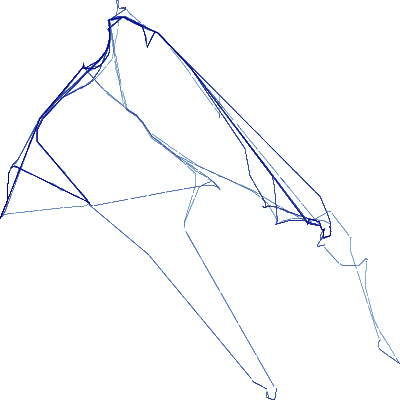

In [15]:
hv.extension('plotly')

mapbox_token = 'pk.eyJ1IjoiYWFkaTM1MCIsImEiOiJja3Bza3hobGswZjlwMnZxdW10cHNhbjY2In0.vSqwwNHlQiFR0QB9lJO0-w'

flat["easting"], flat["northing"] = hv.Tiles.lon_lat_to_easting_northing(
    flat["lon"], flat["lat"]
)
dataset = hv.Dataset(flat)

points = hv.Points(
        flat, ["easting", "northing"]
    ).opts(color="crimson")

tiles = hv.Tiles().opts(mapboxstyle="light", accesstoken=mapbox_token)
overlay = tiles * datashade(points)

min_date = flat.start_date.min()
max_date = flat.start_date.max()
overlay.opts(
    title=f"Equinox Path from {min_date} to {max_date}",
    width=1600,
    height=1000
)

# Attribute Dictionary
## HYCOM Data  
| Atribute | Description | Unit |  
| -------- | -------- | -------- |
| xCO2_EQU_ppm | Mole fraction of CO2 in the equilibrator headspace (dry) at equilibrator temperature (ppm) | ppm | 
| xCO2_ATM_ppm | Mole fraction of CO2 measured in dry outside air (ppm) | ppm | 
| xCO2_ATM_interpolated_ppm | Mole fraction of CO2 in outside air associated with each water analysi| ppm | 
| PRES_EQU_hPa | Barometric pressure in the equilibrator headspace (hPa) | hPa | 
| PRES_ATM@SSP_hPa | Barometric pressure measured outside, corrected to sea level (hPa)  | hPa | 
| TEMP_EQU_C | Water temperature in equilibrator (°C) | Degree C | 
| SST_C | Sea surface temperature (°C) | Degree C | 
| SAL_permil | Sea surface salinity on Practical Salinity Scale (o/oo) | ppt | 
| fCO2_SW@SST_uatm | Fugacity of CO2 in sea water at SST and 100% humidity (μatm) | μatm | 
| fCO2_ATM_interpolated_uatm | Fugacity of CO2 in air corresponding to the interpolated xCO2 at SST and 100% humidity (μatm) | μatm | 
| dfCO2_uatm | Sea water fCO2 minus interpolated air fCO2 (μatm) | μatm | 
| WOCE_QC_FLAG | Quality control flag for fCO2 values (2=good, 3=questionable) | None | 
| QC_SUBFLAG | Quality control subflag for fCO2 values, provides explanation when QC flag=3 | None |

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
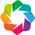

,DATE_UTC,LAT,LONG,xCO2_EQU_ppm,xCO2_ATM_interpolated_ppm,PRES_EQU_hPa,PRES_ATM@SSP_hPa,TEMP_EQU_C,SST_C,SAL_permil,fCO2_SW@SST_uatm,fCO2_ATM_interpolated_uatm,dfCO2_uatm,WOCE_QC_FLAG
0,18012019,19.3628,-87.0567,409.209,416.23,1020.2,1019.5287,27.47,27.3995,35.9750,395.09,400.59,-5.50,2.0
1,4102019,25.3697,-80.0358,434.359,413.27,1013.9,1012.8615,29.19,29.2532,36.2800,417.47,395.66,21.81,2.0
2,2032020,21.0525,-69.5518,385.030,429.29,1021.5,1018.7487,26.15,26.1560,36.4966,374.44,416.21,-41.77,2.0
3,17032019,22.0518,-71.0227,382.595,420.52,1020.6,1014.6268,26.12,26.0778,36.3151,371.00,403.80,-32.80,2.0
4,12012019,25.8340,-79.9258,-999.000,-999.00,-999.0,-999.0000,-999.00,-999.0000,-999.0000,-999.00,-999.00,-999.00,3.0


In [3]:
hv.extension('bokeh')

equinox = cudf.read_csv(os.path.join(RES_PATH, 'equinox/equinox-201920.csv'))

equinox = equinox.drop(['YD_UTC'], axis=1)
equinox = equinox.groupby(['DATE_UTC', 'LAT', 'LONG']).agg('mean').reset_index()
equinox.head()

In [4]:
from tqdm.notebook import tqdm
tqdm.pandas()

equinox['DATE_UTC'] = equinox['DATE_UTC'].astype(str)

def format_datestring(row):
    year = row[-4:]
    month = row[-6:-4]
    day = row[:-6]
    if len(day) == 1:
        day = '0' + day
    return str(year + '-' + month + '-' + day)
    
equinox['DATE_UTC'] = equinox.to_pandas().progress_apply(lambda x: format_datestring(x[0]), axis=1)

  0%|          | 0/116213 [00:00<?, ?it/s]

In [5]:
equinox.head()

,DATE_UTC,LAT,LONG,xCO2_EQU_ppm,xCO2_ATM_interpolated_ppm,PRES_EQU_hPa,PRES_ATM@SSP_hPa,TEMP_EQU_C,SST_C,SAL_permil,fCO2_SW@SST_uatm,fCO2_ATM_interpolated_uatm,dfCO2_uatm,WOCE_QC_FLAG
0,2019-01-18,19.3628,-87.0567,409.209,416.23,1020.2,1019.5287,27.47,27.3995,35.9750,395.09,400.59,-5.50,2.0
1,2019-10-04,25.3697,-80.0358,434.359,413.27,1013.9,1012.8615,29.19,29.2532,36.2800,417.47,395.66,21.81,2.0
2,2020-03-02,21.0525,-69.5518,385.030,429.29,1021.5,1018.7487,26.15,26.1560,36.4966,374.44,416.21,-41.77,2.0
3,2019-03-17,22.0518,-71.0227,382.595,420.52,1020.6,1014.6268,26.12,26.0778,36.3151,371.00,403.80,-32.80,2.0
4,2019-01-12,25.8340,-79.9258,-999.000,-999.00,-999.0,-999.0000,-999.00,-999.0000,-999.0000,-999.00,-999.00,-999.00,3.0


In [9]:
flat.head()

,start_date,lat,lon,water_temp_0,salinity_0,water_temp_2,salinity_2,water_temp_4,salinity_4,water_temp_6,salinity_6,water_temp_8,salinity_8,easting,northing
0,2019-09-01,21.8720,-76.9305,30.157375,36.483625,30.028250,36.485500,29.878750,36.491750,29.835875,36.493000,29.805875,36.495000,-8.563864e+06,2.496164e+06
1,2019-08-02,23.3202,-83.1797,30.035125,36.131000,30.030250,36.131625,30.022375,36.132000,30.014375,36.132250,30.005625,36.132625,-9.259522e+06,2.670788e+06
2,2020-03-09,22.2268,-85.0652,26.616000,36.110375,26.633875,36.109375,26.637875,36.109125,26.638250,36.108875,26.637875,36.108875,-9.469415e+06,2.538777e+06
3,2020-02-21,25.6228,-76.6150,25.096625,36.664125,25.032750,36.664500,25.032875,36.664000,25.028500,36.663375,25.021250,36.662875,-8.528743e+06,2.952438e+06
4,2019-02-21,23.5457,-73.2785,25.722125,36.717875,25.728125,36.717750,25.727250,36.717375,25.725000,36.717000,25.722500,36.716750,-8.157325e+06,2.698147e+06


In [10]:
merged_df = cudf.merge(flat, equinox,  how='inner', left_on=['start_date','lat', 'lon'], right_on = ['DATE_UTC','LAT', 'LONG'])
merged_df.sample(10)

,start_date,lat,lon,water_temp_0,salinity_0,water_temp_2,salinity_2,water_temp_4,salinity_4,water_temp_6,...,xCO2_ATM_interpolated_ppm,PRES_EQU_hPa,PRES_ATM@SSP_hPa,TEMP_EQU_C,SST_C,SAL_permil,fCO2_SW@SST_uatm,fCO2_ATM_interpolated_uatm,dfCO2_uatm,WOCE_QC_FLAG
96122,2019-11-07,19.4997,-82.0765,29.213625,36.244375,29.221000,36.244250,29.219250,36.244250,29.216125,...,413.84,1014.32,1013.1554,29.62,29.6850,36.3189,411.31,395.92,15.39,2.0
102109,2019-03-15,20.2527,-82.8782,26.968000,35.982875,26.954625,35.982875,26.948625,35.982875,26.941000,...,413.45,1019.30,1017.0190,27.26,27.1964,36.1500,397.36,397.08,0.28,2.0
89942,2019-09-06,25.8668,-77.4812,28.583875,36.179125,28.558125,36.178875,28.536250,36.178625,28.513125,...,414.31,1015.90,1014.0709,29.03,29.1112,36.2100,418.71,397.28,21.43,2.0
97610,2019-09-05,20.1823,-66.3840,29.132625,35.810625,29.135750,35.809625,29.131875,35.809500,29.127250,...,407.11,1018.00,1016.7787,29.41,29.4997,35.9100,415.46,391.10,24.36,2.0
87177,2019-10-09,12.2517,-69.4128,29.506750,35.586625,29.513750,35.586125,29.512500,35.585875,29.509625,...,412.79,1009.10,1008.7339,29.49,29.5392,36.0900,426.05,393.26,32.79,2.0
60217,2020-01-18,26.1780,-79.2855,25.431125,36.305625,25.452250,36.304875,25.457125,36.304750,25.460500,...,424.44,1027.00,1026.4894,26.23,26.2696,36.5346,396.50,414.65,-18.14,2.0
73643,2020-02-06,23.2735,-72.9317,24.948500,36.480125,24.948750,36.479500,24.943625,36.479250,24.937750,...,416.04,1016.71,1016.4439,25.73,25.8505,36.7682,375.51,402.67,-27.16,2.0
109624,2019-08-05,20.7472,-69.1167,28.995125,36.130000,28.998875,36.129000,28.994750,36.128375,28.990375,...,413.76,1019.00,1017.3874,29.11,29.2124,35.7800,415.36,398.00,17.36,2.0
64662,2019-11-17,24.3275,-81.2767,27.365000,36.144500,27.345875,36.144875,27.330875,36.145125,27.323000,...,417.94,1011.37,1010.3709,27.92,27.9772,36.1851,397.08,400.26,-3.18,2.0
8353,2020-01-07,20.7202,-86.8225,27.314875,36.278625,27.165000,36.280375,27.174000,36.280125,27.179000,...,416.68,1019.60,1019.5234,27.76,27.8636,36.1840,397.01,402.90,-5.88,2.0


In [11]:
merged_df = merged_df.drop(['DATE_UTC', 'LAT', 'LONG'], axis=1)
merged_df.to_csv(os.path.join(RES_PATH, 'hycom', 'hycom_equinox_merged-201920.csv'), index=False)

WOCE_QC_FLAG gives the status of the Equilibrator and serves as an indicator of whether the unit is functioning nominally. The data is filtered such that WOCE_QC_FLAG==2
Additionally, values where the fugacity were reported to be less than zero are removed

In [19]:
merged_df = merged_df.loc[(merged_df.WOCE_QC_FLAG == 2) & (merged_df['fCO2_SW@SST_uatm'] >= 0), :]
merged_df.head()

,start_date,lat,lon,water_temp_0,salinity_0,water_temp_2,salinity_2,water_temp_4,salinity_4,water_temp_6,...,xCO2_ATM_interpolated_ppm,PRES_EQU_hPa,PRES_ATM@SSP_hPa,TEMP_EQU_C,SST_C,SAL_permil,fCO2_SW@SST_uatm,fCO2_ATM_interpolated_uatm,dfCO2_uatm,WOCE_QC_FLAG
0,2019-11-19,19.0418,-87.4192,28.641375,36.191375,28.48175,36.194000,28.490375,36.193750,28.494625,...,410.81,1014.72,1013.5662,29.14,29.1692,36.2848,410.02,393.66,16.36,2.0
1,2020-01-21,18.3305,-65.1468,26.471600,35.826667,26.42980,35.825867,26.429333,35.828200,26.426533,...,417.55,1015.40,1014.5055,27.25,27.3215,35.3726,390.25,402.13,-11.88,2.0
2,2019-07-31,19.7638,-87.1375,29.324125,36.082625,29.24825,36.083875,29.235125,36.083500,29.218875,...,410.89,1014.90,1014.5565,29.98,29.7258,36.2400,435.94,393.63,42.32,2.0
3,2019-09-13,25.9173,-79.9605,29.782625,36.122750,29.79925,36.123500,29.802750,36.124125,29.803750,...,414.53,1012.47,1011.9442,29.88,29.9378,35.4666,413.24,395.84,17.40,2.0
4,2019-08-11,23.2150,-83.5792,30.861500,36.154125,30.54200,36.152875,30.412500,36.150375,30.245500,...,417.82,1017.40,1017.0594,30.57,30.6395,36.3900,442.06,400.40,41.66,2.0


In [20]:
import tensorflow_data_validation as tfdv

stats = tfdv.generate_statistics_from_dataframe(merged_df.to_pandas())
tfdv.visualize_statistics(stats)

# Noteworthy from Above
Columns with missing values as -999
    'xCO2_EQU_ppm', 
    'xCO2_ATM_interpolated_ppm',
    'PRES_EQU_hPa', 
    'PRES_ATM@SSP_hPa', 
    'TEMP_EQU_C', 
    'SST_C', 
    'SAL_permil',
    'fCO2_SW@SST_uatm',
    'fCO2_ATM_interpolated_uatm',
    'dfCO2_uatm'
 
 Columns with missing values as NaNs
    'water_temp_0', 
    'salinity_0',
    'water_temp_2', 
    'salinity_2', 
    'water_temp_4', 
    'salinity_4',
    'water_temp_6',
    'salinity_6', 
    'water_temp_8', 
    'salinity_8'

In [ ]:
sorted(merged_df.columns)

# ['PRES_ATM@SSP_hPa',
# 'PRES_EQU_hPa',
# 'SAL_permil',
# 'SST_C',
# 'TEMP_EQU_C',
# 'WOCE_QC_FLAG',
# 'dfCO2_uatm',
# 'easting',
# 'fCO2_ATM_interpolated_uatm',
# 'fCO2_SW@SST_uatm',
# 'lat',
# 'lon',
# 'northing',
# 'salinity_0',
# 'salinity_2',
# 'salinity_4',
# 'salinity_6',
# 'salinity_8',
# 'start_date',
# 'water_temp_0',
# 'water_temp_2',
# 'water_temp_4',
# 'water_temp_6',
# 'water_temp_8',
# 'xCO2_ATM_interpolated_ppm',
# 'xCO2_EQU_ppm']

In [15]:
equinox_cols = equinox.columns

Index(['DATE_UTC', 'LAT', 'LONG', 'xCO2_EQU_ppm', 'xCO2_ATM_interpolated_ppm',
       'PRES_EQU_hPa', 'PRES_ATM@SSP_hPa', 'TEMP_EQU_C', 'SST_C', 'SAL_permil',
       'fCO2_SW@SST_uatm', 'fCO2_ATM_interpolated_uatm', 'dfCO2_uatm',
       'WOCE_QC_FLAG'],
      dtype='object')

### Mole fraction of CO2 in the equilibrator headspace

In [153]:
equinox_cols = ['xCO2_EQU_ppm', 'xCO2_ATM_interpolated_ppm',
       'PRES_EQU_hPa', 'PRES_ATM@SSP_hPa', 'TEMP_EQU_C', 'SST_C', 'SAL_permil',
       'fCO2_SW@SST_uatm', 'fCO2_ATM_interpolated_uatm', 'dfCO2_uatm']

equinox_col_names = dict({
    'xCO2_EQU_ppm': 'Mole fraction of CO2 in the equilibrator headspace (ppm)', 
    'xCO2_ATM_interpolated_ppm': 'Mole fraction of CO2 measured in dry outside air (ppm)',
    'PRES_EQU_hPa': 'Barometric pressure in the equilibrator headspace (hPa)', 
    'PRES_ATM@SSP_hPa':  'Barometric pressure measured outside, corrected to sea level (hPa)',
    'TEMP_EQU_C': 'Water temperature in equilibrator (°C)', 
    'SST_C': 'Sea surface temperature (°C)',
    'SAL_permil': 'Sea surface salinity on Practical Salinity Scale (ppt)',
    'fCO2_SW@SST_uatm': 'Fugacity of CO2 in sea water at SST and 100% humidity (μatm)',
    'fCO2_ATM_interpolated_uatm': 'Fugacity of CO2 in air corresponding to the interpolated xCO2 at SST and 100% humidity (μatm)',
    'dfCO2_uatm': 'Sea water fCO2 minus interpolated air fCO2 (μatm)' ,
    })


salinity_cols = ['salinity_0',
                'salinity_2',
                'salinity_4',
                'salinity_6',
                'salinity_8']

water_temp_cols = ['water_temp_0',
                'water_temp_2',
                'water_temp_4',
                'water_temp_6',
                'water_temp_8']




def plot_correlation(sentinel_col):    
    graph_list = []
    hv_data = hv.Dataset(merged_df)
    
    for idx, col in enumerate(equinox_cols):
        scatter = hv.Scatter(hv_data, kdims=sentinel_col, vdims=col).opts(width=600, height=400, title=equinox_col_names[col])
        scatter.redim(y=hv.Dimension(col, range=(0, merged_df[col].max())))
        shaded = decimate(scatter, y_range=(0, merged_df[col].max())).opts(width=800,  height=400)
        graph_list.append(shaded)
        del scatter
            
    layout = hv.Layout(graph_list).cols(2)
    return layout
    

plot_correlation(salinity_cols[0])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [salinity_0]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [salinity_0]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [salinity_0]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [salinity_0]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [salinity_0]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [salinity_0]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [salinity_0]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [salinity_0]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [salinity_0]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [salinity_0]   (dfCO2_uatm)

In [154]:
plot_correlation(salinity_cols[1])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [salinity_2]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [salinity_2]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [salinity_2]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [salinity_2]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [salinity_2]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [salinity_2]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [salinity_2]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [salinity_2]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [salinity_2]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [salinity_2]   (dfCO2_uatm)

In [155]:
plot_correlation(salinity_cols[2])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [salinity_4]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [salinity_4]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [salinity_4]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [salinity_4]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [salinity_4]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [salinity_4]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [salinity_4]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [salinity_4]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [salinity_4]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [salinity_4]   (dfCO2_uatm)

In [156]:
plot_correlation(salinity_cols[3])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [salinity_6]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [salinity_6]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [salinity_6]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [salinity_6]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [salinity_6]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [salinity_6]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [salinity_6]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [salinity_6]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [salinity_6]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [salinity_6]   (dfCO2_uatm)

In [157]:
plot_correlation(salinity_cols[4])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [salinity_8]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [salinity_8]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [salinity_8]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [salinity_8]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [salinity_8]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [salinity_8]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [salinity_8]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [salinity_8]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [salinity_8]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [salinity_8]   (dfCO2_uatm)

In [158]:
plot_correlation(water_temp_cols[0])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [water_temp_0]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [water_temp_0]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [water_temp_0]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [water_temp_0]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [water_temp_0]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [water_temp_0]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [water_temp_0]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [water_temp_0]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [water_temp_0]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [water_temp_0]   (dfCO2_uatm)

In [159]:
plot_correlation(water_temp_cols[1])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [water_temp_2]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [water_temp_2]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [water_temp_2]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [water_temp_2]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [water_temp_2]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [water_temp_2]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [water_temp_2]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [water_temp_2]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [water_temp_2]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [water_temp_2]   (dfCO2_uatm)

In [160]:
plot_correlation(water_temp_cols[2])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [water_temp_4]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [water_temp_4]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [water_temp_4]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [water_temp_4]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [water_temp_4]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [water_temp_4]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [water_temp_4]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [water_temp_4]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [water_temp_4]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [water_temp_4]   (dfCO2_uatm)

In [161]:
plot_correlation(water_temp_cols[3])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [water_temp_6]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [water_temp_6]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [water_temp_6]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [water_temp_6]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [water_temp_6]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [water_temp_6]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [water_temp_6]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [water_temp_6]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [water_temp_6]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [water_temp_6]   (dfCO2_uatm)

In [162]:
plot_correlation(water_temp_cols[4])

:Layout
   .DynamicMap.I    :DynamicMap   []
      :Scatter   [water_temp_8]   (xCO2_EQU_ppm)
   .DynamicMap.II   :DynamicMap   []
      :Scatter   [water_temp_8]   (xCO2_ATM_interpolated_ppm)
   .DynamicMap.III  :DynamicMap   []
      :Scatter   [water_temp_8]   (PRES_EQU_hPa)
   .DynamicMap.IV   :DynamicMap   []
      :Scatter   [water_temp_8]   (PRES_ATM@SSP_hPa)
   .DynamicMap.V    :DynamicMap   []
      :Scatter   [water_temp_8]   (TEMP_EQU_C)
   .DynamicMap.VI   :DynamicMap   []
      :Scatter   [water_temp_8]   (SST_C)
   .DynamicMap.VII  :DynamicMap   []
      :Scatter   [water_temp_8]   (SAL_permil)
   .DynamicMap.VIII :DynamicMap   []
      :Scatter   [water_temp_8]   (fCO2_SW@SST_uatm)
   .DynamicMap.IX   :DynamicMap   []
      :Scatter   [water_temp_8]   (fCO2_ATM_interpolated_uatm)
   .DynamicMap.X    :DynamicMap   []
      :Scatter   [water_temp_8]   (dfCO2_uatm)